# Annotations using clustering for cells for colon_s2

In [1]:
slide_id = "colon_s2"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_colon_s2.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 40815, 21507), (3, 20408, 10754)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 11) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (388175, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (388175, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (388175, 480)
      └── 'table_nuclei': AnnData (388175, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 388175 × 480
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'z_level', 'nucleus_count'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,z_level,nucleus_count
0,aaaaaaaa-1,36,0,0,0,0,36,276.627198,78.978284,cell_labels,5.0,1.0
1,aaaaaaab-1,1,0,0,0,0,1,105.575316,4.289844,cell_labels,3.0,1.0
2,aaaaaaac-1,15,0,0,0,0,15,83.855159,8.579688,cell_labels,4.0,1.0
3,aaaaaaad-1,62,0,0,0,0,62,202.390320,33.867189,cell_labels,4.0,1.0
4,aaaaaaae-1,12,0,0,0,0,12,74.417503,12.237344,cell_labels,4.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
388170,aaafomek-1,184,0,0,0,0,184,83.042347,36.666876,cell_labels,7.0,1.0
388171,aaafomel-1,134,0,0,0,0,134,62.044690,33.054376,cell_labels,8.0,1.0
388172,aaafomem-1,166,0,0,0,0,166,75.501253,35.763751,cell_labels,8.0,1.0
388173,aaafomen-1,99,0,0,0,0,99,50.258908,29.667657,cell_labels,8.0,1.0


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
A2M,ENSG00000175899,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTB,ENSG00000075624,Gene Expression,Unknown
ADAM28,ENSG00000042980,Gene Expression,Unknown
...,...,...,...
VSIG4,ENSG00000155659,Gene Expression,Unknown
VSIR,ENSG00000107738,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown
XBP1,ENSG00000100219,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 353364 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs19_leiden_res0.2', 'pca_n10_pcs19_leiden_res0.4', 'pca_n10_pcs19_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs19', 'pca_n10_pcs19_leiden_res0.2', 'pca_n10_pcs19_leiden_res0.2_colors', 'pca_n10_pcs19_leiden_res0.4', 'pca_n10_pcs19_leiden_res0.4_colors', 'pca_n10_pcs19_leiden_res0.6', 'pca_n10_pcs19_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs19_leiden_res0.2', 'rank_genes_pca_n10_pcs19_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs19_connectivities', 'pca_n10_pcs19_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs19_leiden_res0.2,pca_n10_pcs19_leiden_res0.4,pca_n10_pcs19_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,75.297950,Monocyte,11,3,1,2,2,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,31.722175,Light zone GC B cell,46,2,2,4,4,T,T,normal_cell
aaaaaaal-1,nucleus_boundaries,morpho,aaaaaaal-1,21.787988,CCL19/21 fibroblast,14,2,2,11,11,B,B,normal_cell
aaaaaaan-1,nucleus_boundaries,morpho,aaaaaaan-1,15.104799,BNC2+ neuron,12,2,2,3,3,Plasma,Plasma,normal_cell
aaaaaaba-1,nucleus_boundaries,morpho,aaaaaaba-1,9.934369,Neuroblast,16,3,1,2,2,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaafomek-1,nucleus_boundaries,morpho,aaafomek-1,34.522279,ADAMDEC1+CXCL14+ fibroblast,102,0,0,1,1,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell
aaafomel-1,nucleus_boundaries,morpho,aaafomel-1,30.908812,CRYAB+PLAT+ glial cell,71,0,0,1,1,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell
aaafomem-1,nucleus_boundaries,morpho,aaafomem-1,33.504940,CRYAB+PLAT+ glial cell,81,0,0,1,1,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell
aaafomen-1,nucleus_boundaries,morpho,aaafomen-1,27.138832,BNC2+ neuron,59,0,8,7,7,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell


In [9]:
adata_nuclei.var

,mean,std
A2M,0.304533,1.265677
ACE2,0.510162,1.533087
ACTA2,1.257898,2.292760
ACTB,3.938714,2.814346
ADAM28,0.124044,0.802460
...,...,...
VSIG4,0.045991,0.489126
VSIR,0.253823,1.144315
VWA5A,0.402697,1.382702
XBP1,2.421689,2.775393


## 2. Preprocessing

<Axes: >

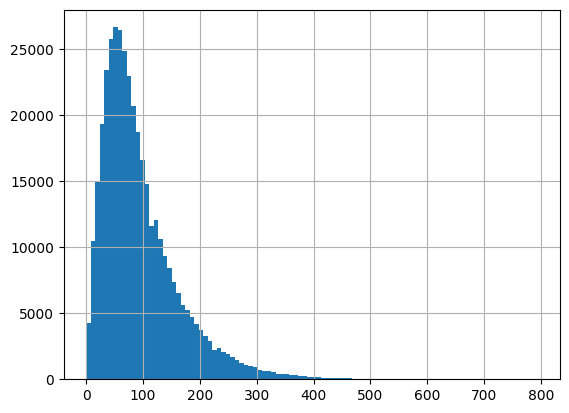

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

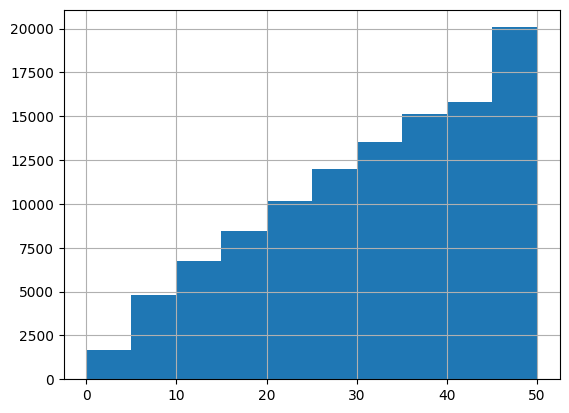

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 21750
Percentage of cells with less than 20 transcripts: 5.6%
-----
Number of cells with less than 15 transcripts: 13281
Percentage of cells with less than 15 transcripts: 3.42%
-----
Number of cells with less than 10 transcripts: 6509
Percentage of cells with less than 10 transcripts: 1.68%
-----
Number total of cells: 388175


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

380431


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


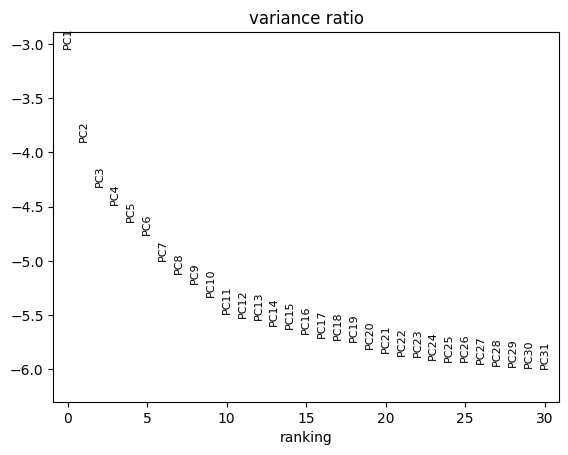

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 380431 × 480
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'z_level', 'nucleus_count'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4202/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


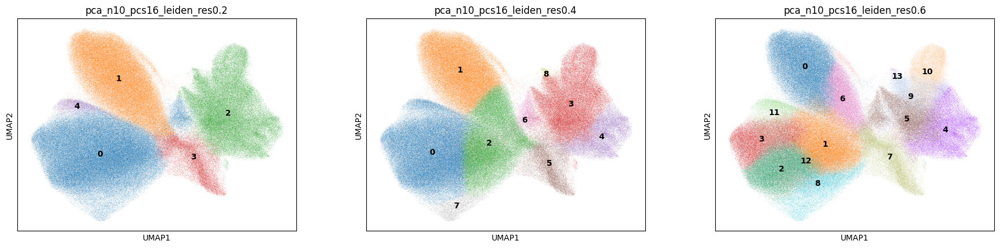

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].unique()

['7', '5', '4', '6', '0', ..., '8', '9', '2', '11', '13']
Length: 14
Categories (14, object): ['0', '1', '2', '3', ..., '10', '11', '12', '13']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['13']), 'refine_res'] = '13'

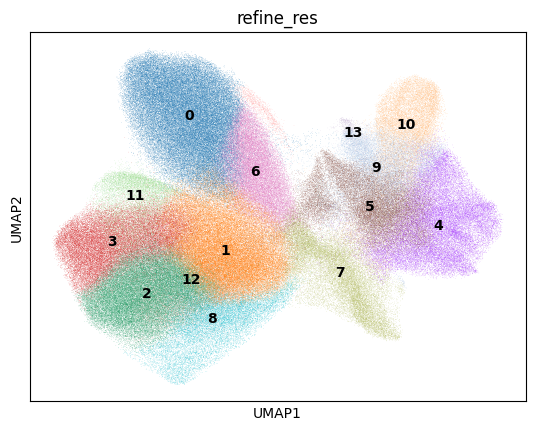

In [25]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

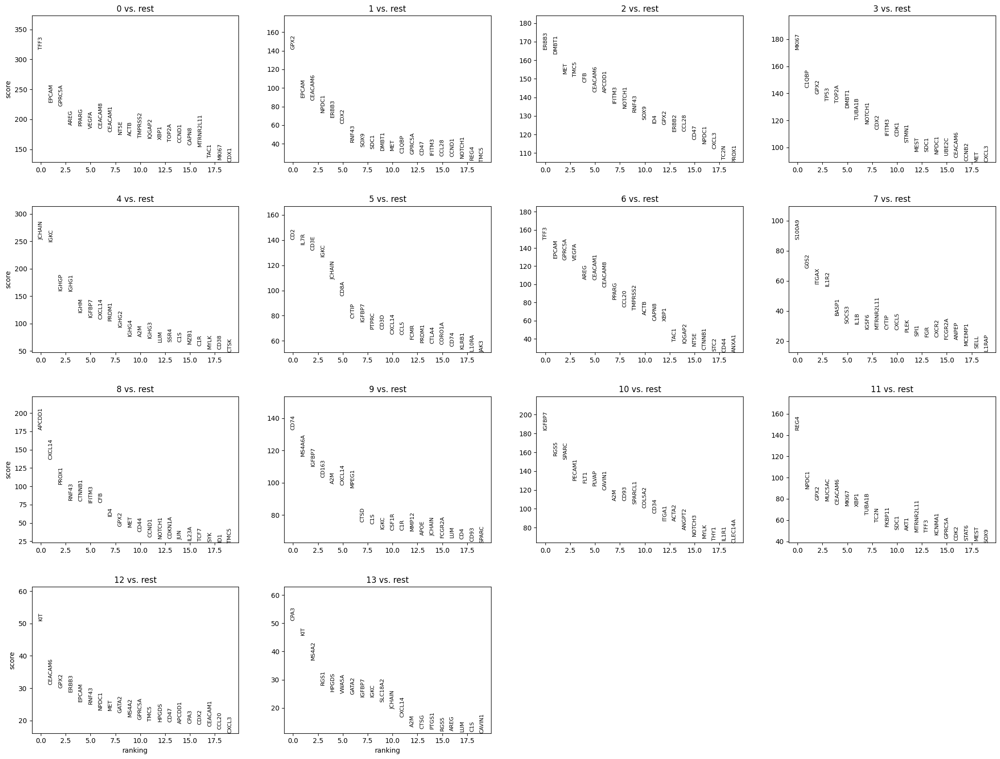

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [31]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,96.6
1,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell,1.8
2,NA,NA,NA,0.9
3,B,B,normal_cell,0.4
4,T,T,normal_cell,0.1


In [33]:
top_ranked_genes[cluster_id]

0       TFF3
1      EPCAM
2     GPRC5A
3       AREG
4      PPARG
5      VEGFA
6    CEACAM8
Name: 0, dtype: object

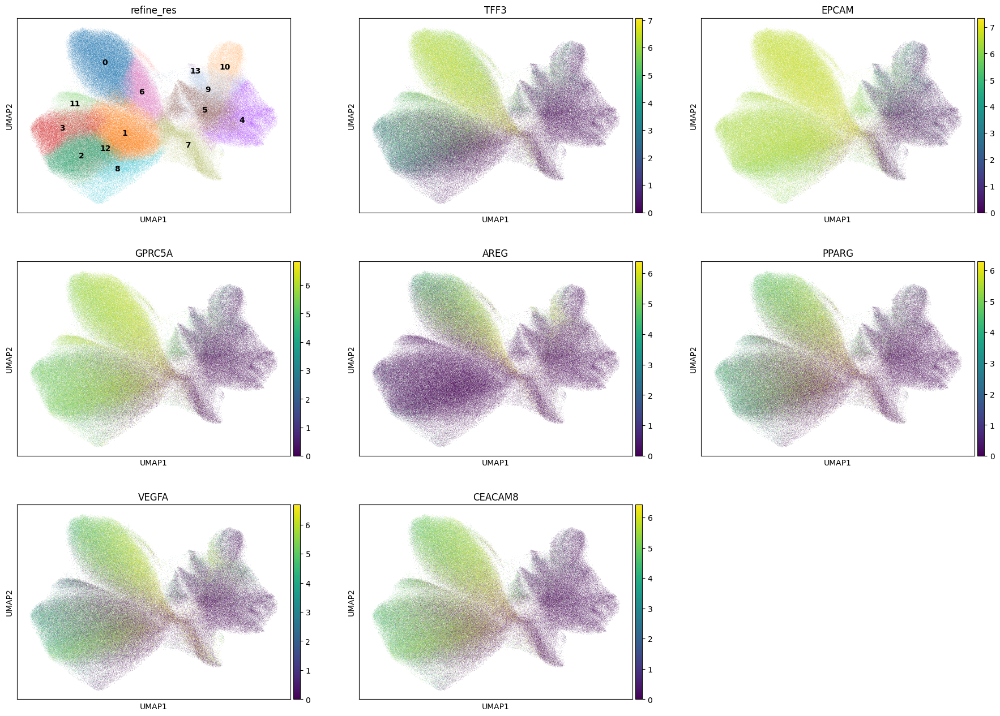

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 68694
Percentage of cells in cluster 0: 18.1


In [36]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Colorectal_epithelial_cell'

### 5.2. Cluster 1

In [37]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,75.2
1,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell,17.8
2,NA,NA,NA,4.3
3,B,B,normal_cell,1.8
4,T,T,normal_cell,0.3


In [39]:
top_ranked_genes[cluster_id]

0       GPX2
1      EPCAM
2    CEACAM6
3      NPDC1
4      ERBB3
5       CDX2
6      RNF43
Name: 1, dtype: object

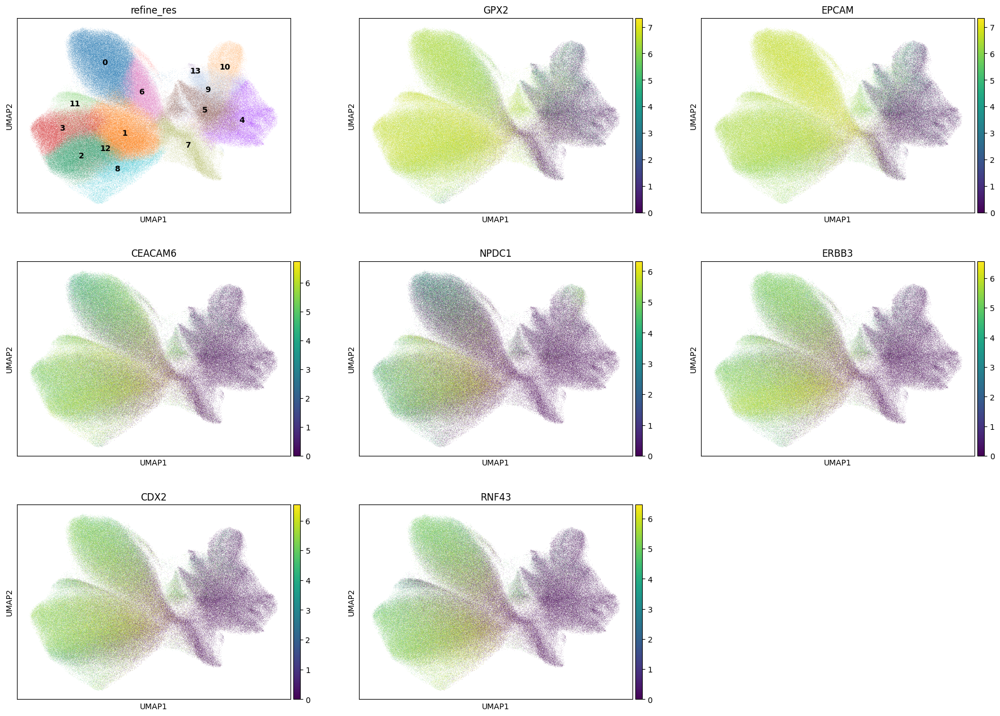

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 55272
Percentage of cells in cluster 1: 14.5


In [42]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Colorectal_epithelial_cell'

### 5.3. Cluster 2

In [43]:
cluster_id = '2'

In [44]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell,76.8
1,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,22.1
2,B,B,normal_cell,0.4
3,NA,NA,NA,0.3
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.2


In [45]:
top_ranked_genes[cluster_id]

0      ERBB3
1      DMBT1
2        MET
3       TMC5
4        CFB
5    CEACAM6
6     APCDD1
Name: 2, dtype: object

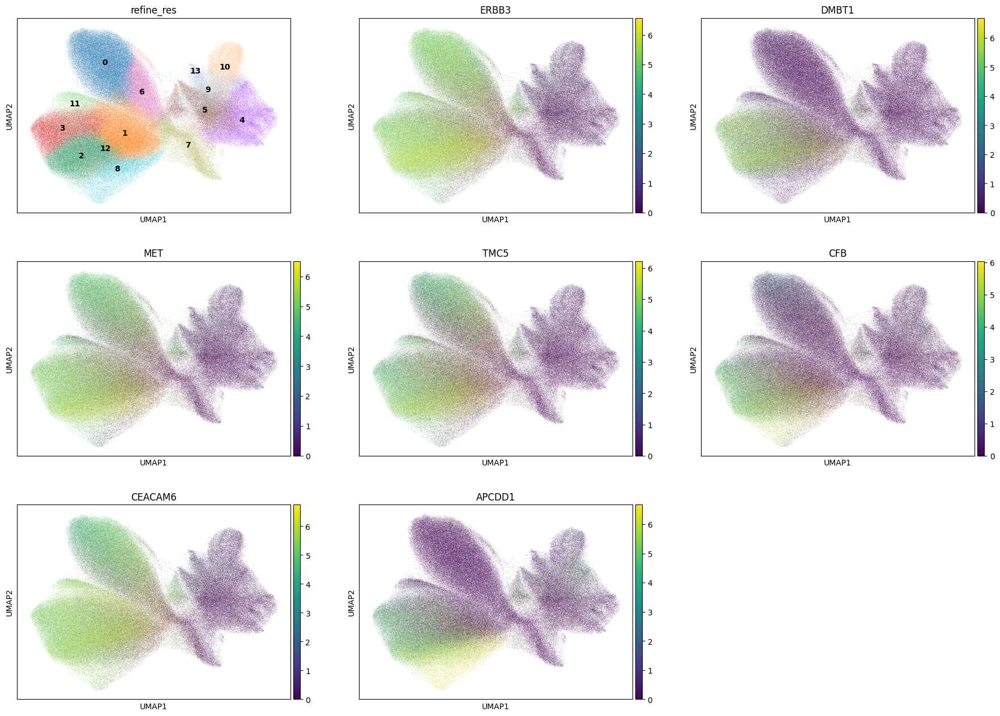

In [46]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 46478
Percentage of cells in cluster 2: 12.2


In [48]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Colorectal_epithelial_cell'

### 5.4. Cluster 3

In [49]:
cluster_id = '3'

In [50]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell,76.9
1,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,21.7
2,B,B,normal_cell,0.5
3,NA,NA,NA,0.4
4,T,T,normal_cell,0.4


In [51]:
top_ranked_genes[cluster_id]

0     MKI67
1     C1QBP
2      GPX2
3      TP53
4     TOP2A
5     DMBT1
6    TUBA1B
Name: 3, dtype: object

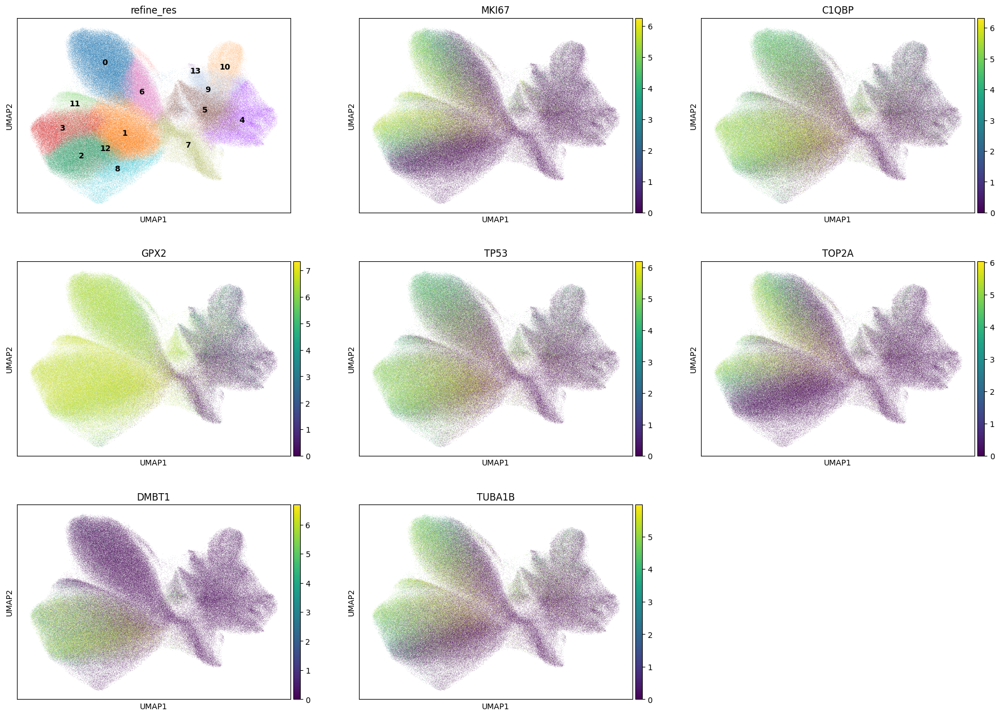

In [52]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 32260
Percentage of cells in cluster 3: 8.5


In [54]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_colorectal_epithelial_cell'

### 5.5. Cluster 4

In [55]:
cluster_id = '4'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,59.1
1,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,14.6
2,NA,NA,NA,13.1
3,T,T,normal_cell,6.4
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,2.9


In [57]:
top_ranked_genes[cluster_id]

0    JCHAIN
1      IGKC
2     IGHGP
3     IGHG1
4      IGHM
5    IGFBP7
6    CXCL14
Name: 4, dtype: object

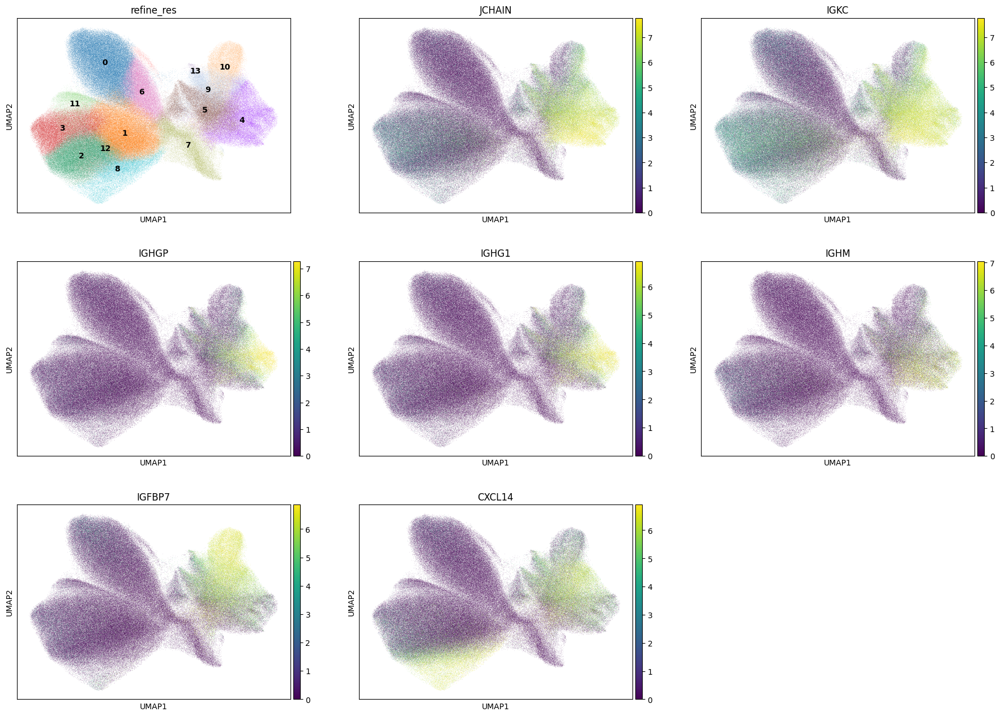

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 32125
Percentage of cells in cluster 4: 8.4


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.6. Cluster 5

In [61]:
cluster_id = '5'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,75.1
1,B,B,normal_cell,6.7
2,Plasma,Plasma,normal_cell,5.6
3,NA,NA,NA,4.9
4,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,3.2


In [63]:
top_ranked_genes[cluster_id]

0       CD2
1      IL7R
2      CD3E
3      IGKC
4    JCHAIN
5      CD8A
6     CYTIP
Name: 5, dtype: object

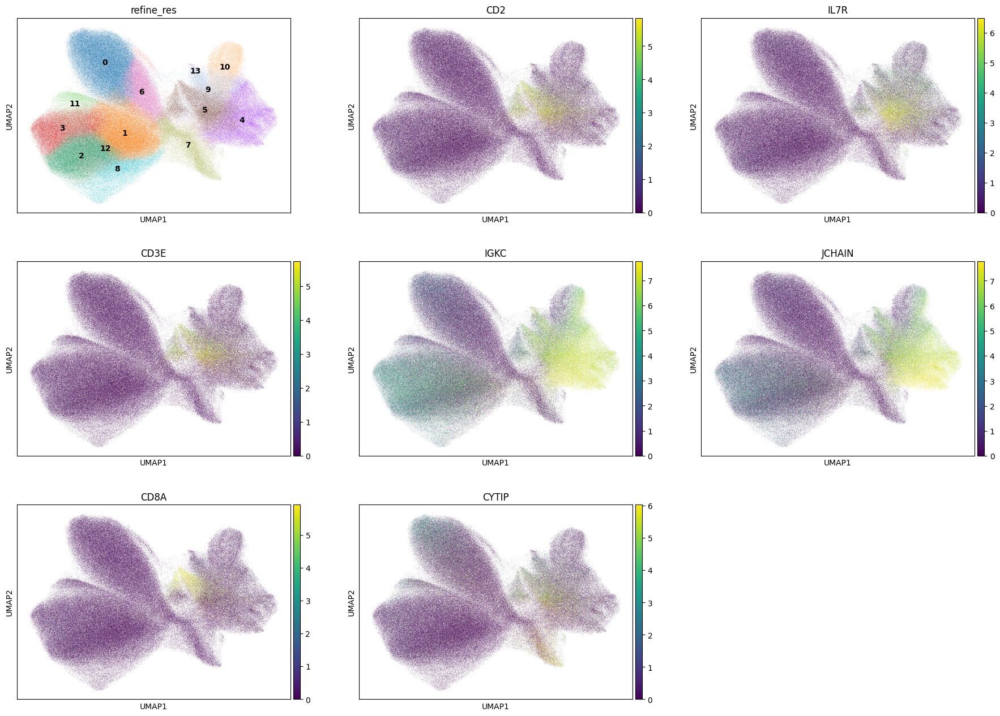

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 28588
Percentage of cells in cluster 5: 7.5


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.7. Cluster 6

In [67]:
cluster_id = '6'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,89.4
1,NA,NA,NA,7.9
2,B,B,normal_cell,1.1
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.7
4,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell,0.6


In [69]:
top_ranked_genes[cluster_id]

0       TFF3
1      EPCAM
2     GPRC5A
3      VEGFA
4       AREG
5    CEACAM1
6    CEACAM8
Name: 6, dtype: object

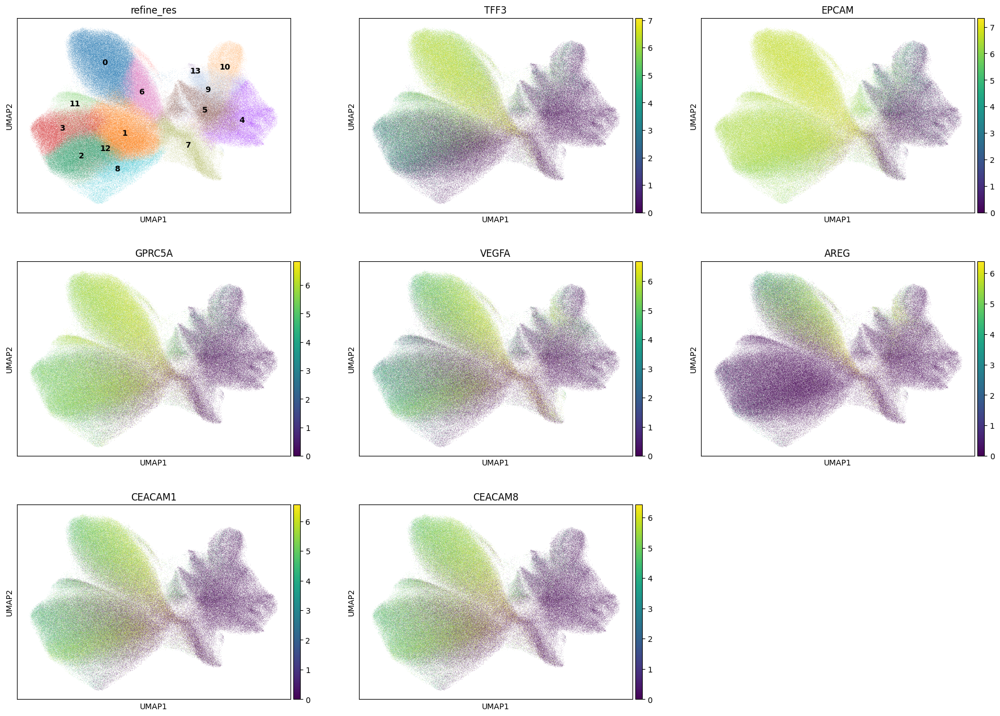

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 26253
Percentage of cells in cluster 6: 6.9


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Colorectal_epithelial_cell'

### 5.8. Cluster 7

In [113]:
cluster_id = '7'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,50.5
1,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,30.9
2,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,14.3
3,Plasma,Plasma,normal_cell,2.5
4,T,T,normal_cell,0.8


In [75]:
top_ranked_genes[cluster_id]

0    S100A9
1      G0S2
2     ITGAX
3     IL1R2
4     BASP1
5     SOCS3
6      IL1B
Name: 7, dtype: object

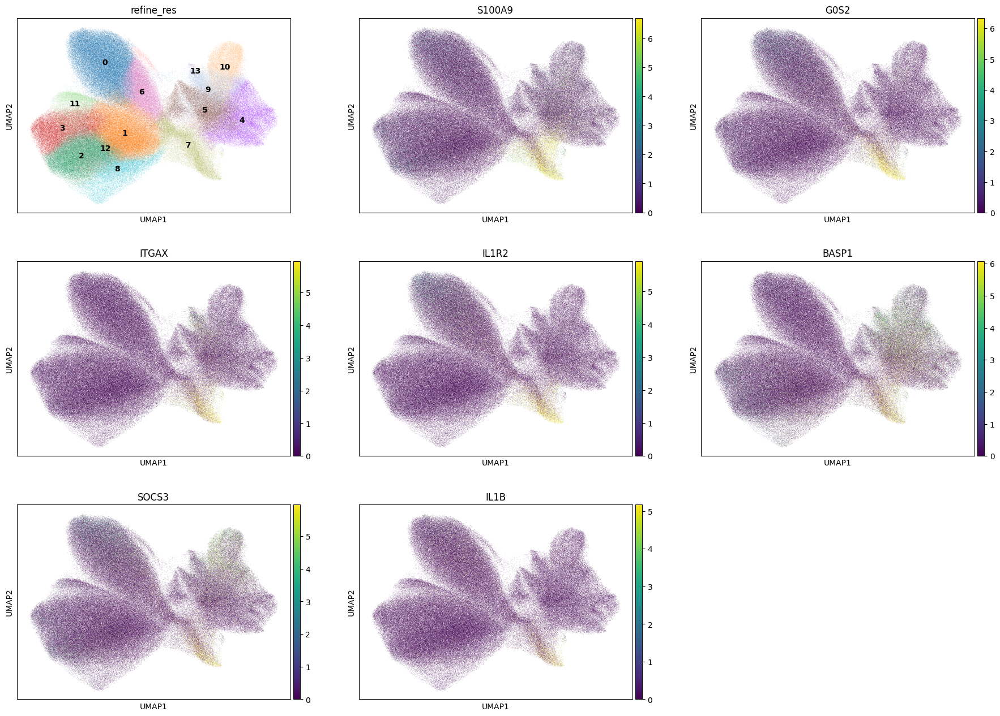

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 23536
Percentage of cells in cluster 7: 6.2


In [114]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.9. Cluster 8

In [115]:
cluster_id = '8'

In [116]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,81.9
1,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell,11.9
2,NA,NA,NA,4.2
3,B,B,normal_cell,0.9
4,T,T,normal_cell,0.4


In [117]:
top_ranked_genes[cluster_id]

0    APCDD1
1    CXCL14
2     PROX1
3     RNF43
4    CTNNB1
5    IFITM3
6       CFB
Name: 8, dtype: object

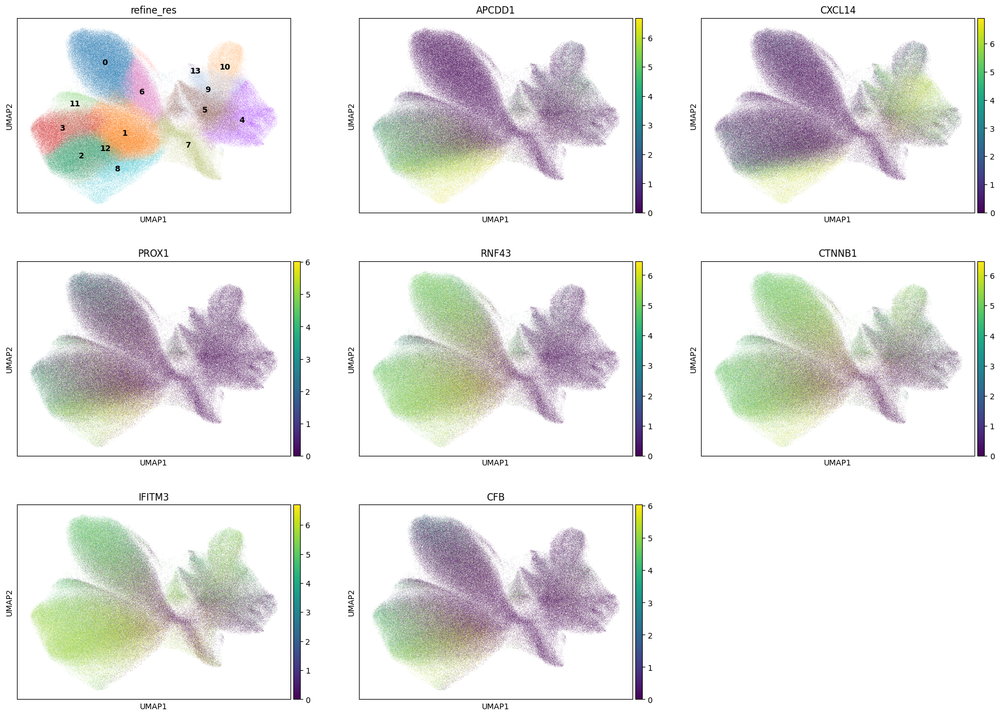

In [118]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [119]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 17191
Percentage of cells in cluster 8: 4.5


In [120]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Colorectal_epithelial_cell'

### 5.10. Cluster 9

In [79]:
cluster_id = '9'

In [80]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,48.4
1,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,26.8
2,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,8.6
3,NA,NA,NA,5.8
4,T,T,normal_cell,4.7


In [81]:
top_ranked_genes[cluster_id]

0      CD74
1    MS4A6A
2    IGFBP7
3     CD163
4       A2M
5    CXCL14
6     MPEG1
Name: 9, dtype: object

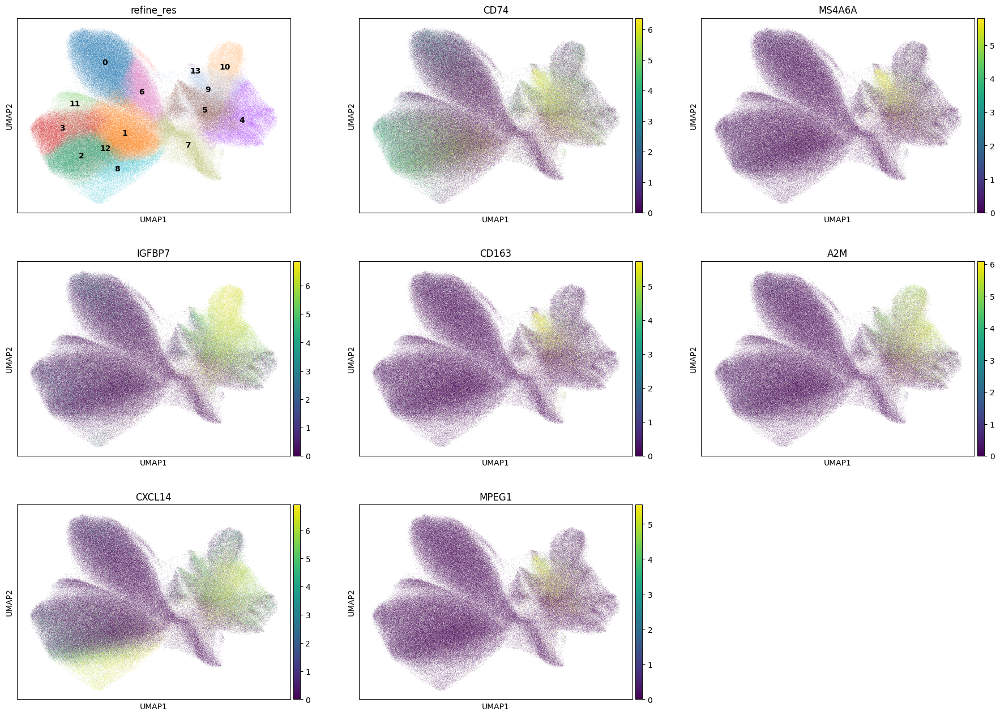

In [82]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 16616
Percentage of cells in cluster 9: 4.4


In [84]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Macrophage'

### 5.11. Cluster 10

In [85]:
cluster_id = '10'

In [86]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,38.2
1,Endothelial,Angiogenesis_endothelial_cells,normal_cell,36.2
2,NA,NA,NA,15.1
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,3.3
4,Plasma,Plasma,normal_cell,3.3


In [87]:
top_ranked_genes[cluster_id]

0    IGFBP7
1      RGS5
2     SPARC
3    PECAM1
4      FLT1
5     PLVAP
6    CAVIN1
Name: 10, dtype: object

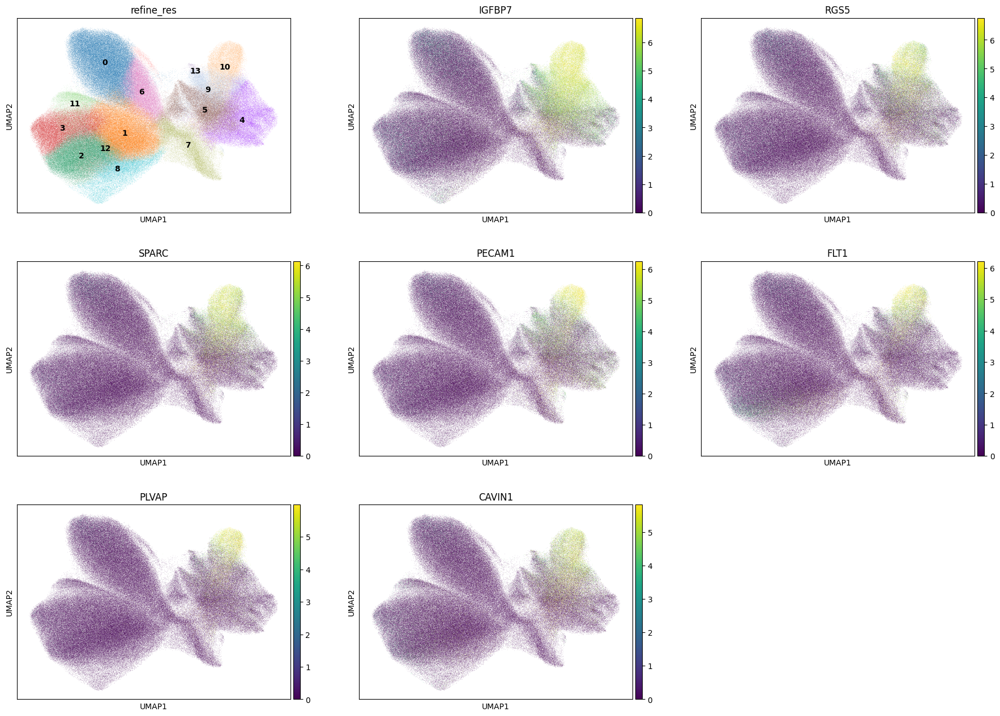

In [88]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 15648
Percentage of cells in cluster 10: 4.1


In [90]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Angiogenic_endothelial_cell'

### 5.12. Cluster 11

In [91]:
cluster_id = '11'

In [92]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,87.4
1,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell,12.1
2,NA,NA,NA,0.2
3,T,T,normal_cell,0.2
4,B,B,normal_cell,0.1


In [93]:
top_ranked_genes[cluster_id]

0       REG4
1      NPDC1
2       GPX2
3     MUC5AC
4    CEACAM6
5      MKI67
6       XBP1
Name: 11, dtype: object

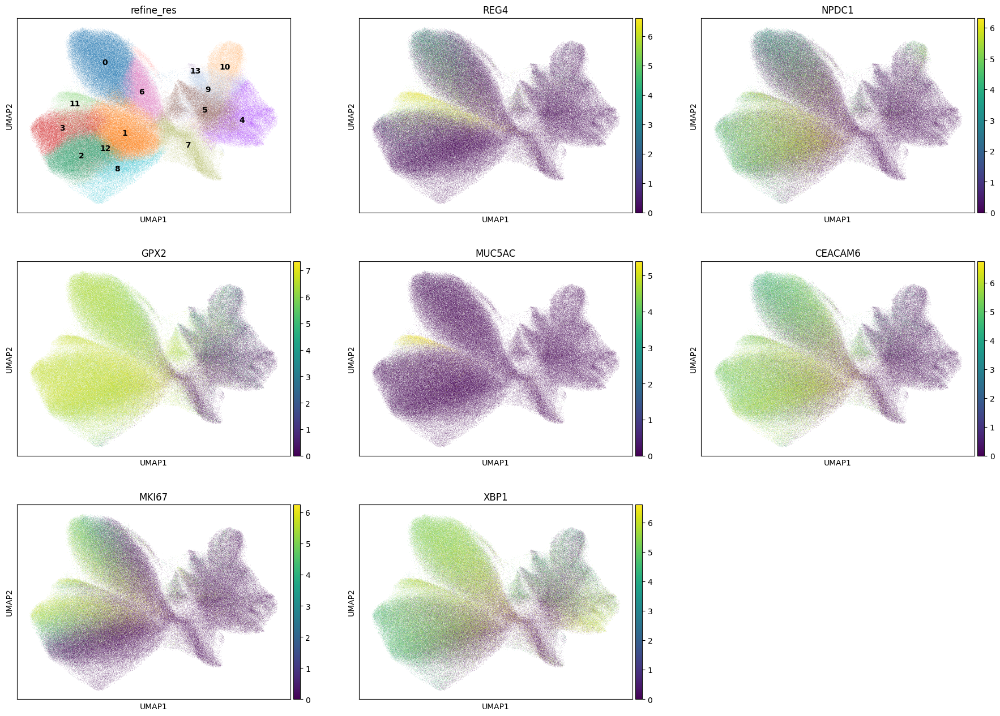

In [94]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [95]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 9867
Percentage of cells in cluster 11: 2.6


In [96]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Secretory_colorectal_epithelial_cell'

### 5.13. Cluster 12

In [97]:
cluster_id = '12'

In [98]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,72.0
1,Epithelial,Cancerous_intestinal_epithelial_cells_with_ste...,cancer_cell,23.9
2,NA,NA,NA,2.8
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.4
4,B,B,normal_cell,0.3


In [99]:
top_ranked_genes[cluster_id]

0        KIT
1    CEACAM6
2       GPX2
3      ERBB3
4      EPCAM
5      RNF43
6      NPDC1
Name: 12, dtype: object

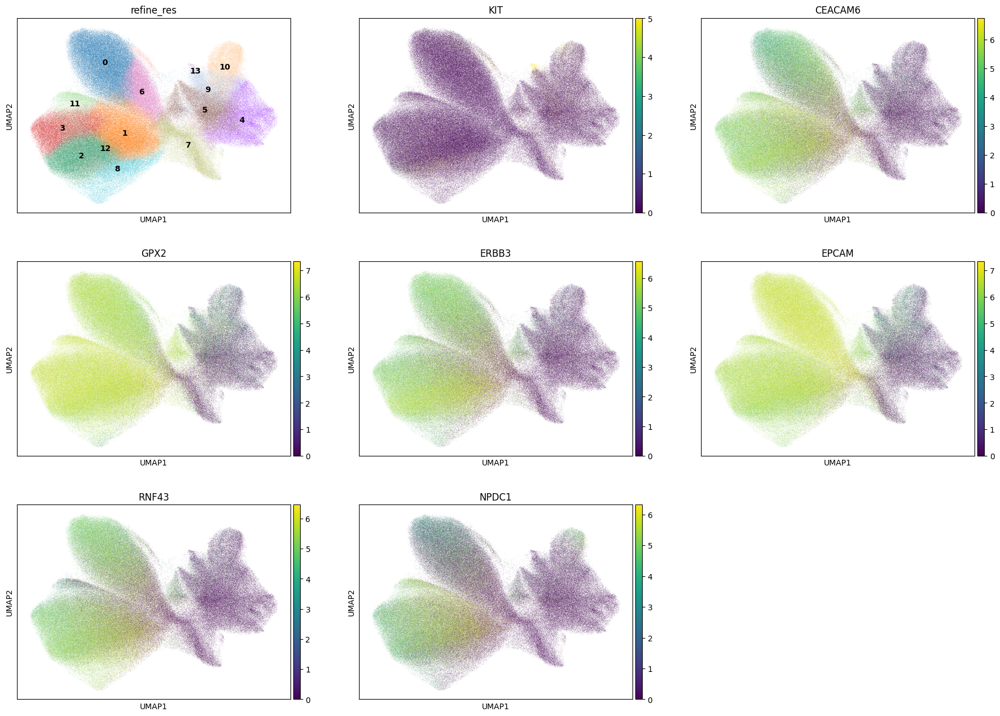

In [100]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [101]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 6964
Percentage of cells in cluster 12: 1.8


In [102]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Colorectal_epithelial_cell'

### 5.14. Cluster 13

In [103]:
cluster_id = '13'

In [104]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,71.6
1,Plasma,Plasma,normal_cell,8.8
2,NA,NA,NA,7.9
3,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,4.9
4,Epithelial,Cancerous_intestinal_epithelial_cell,cancer_cell,2.7


In [105]:
top_ranked_genes[cluster_id]

0     CPA3
1      KIT
2    MS4A2
3     RGS1
4    HPGDS
5    VWA5A
6    GATA2
Name: 13, dtype: object

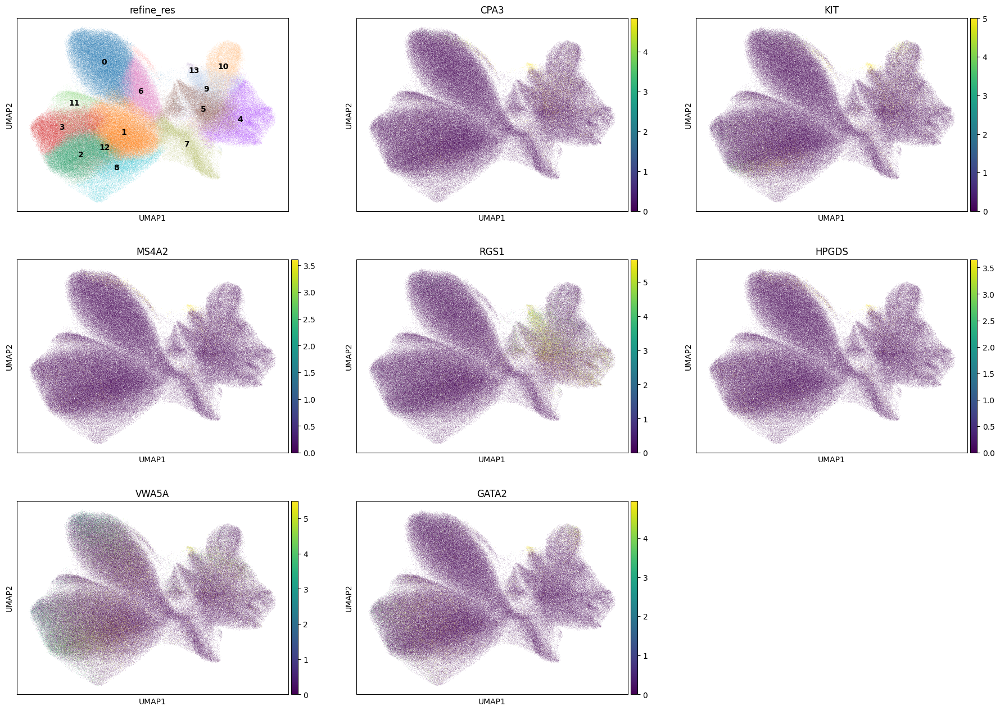

In [106]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [107]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 939
Percentage of cells in cluster 13: 0.2


In [108]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

## 6. Cancer cells

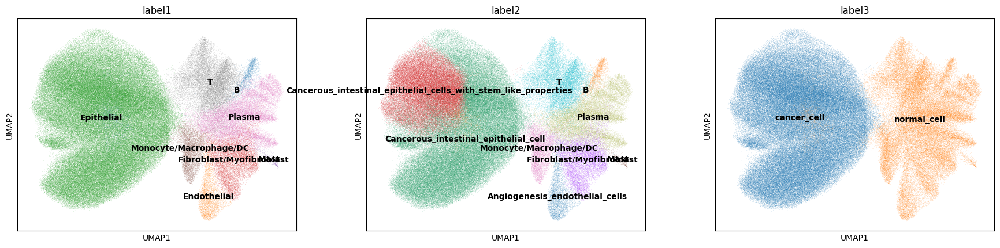

In [111]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

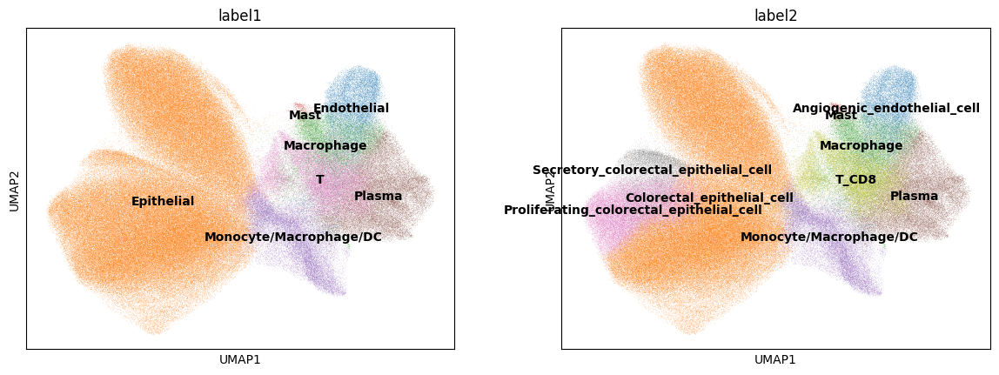

In [121]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [122]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Epithelial']), 'label3'] = 'cancer_cell'

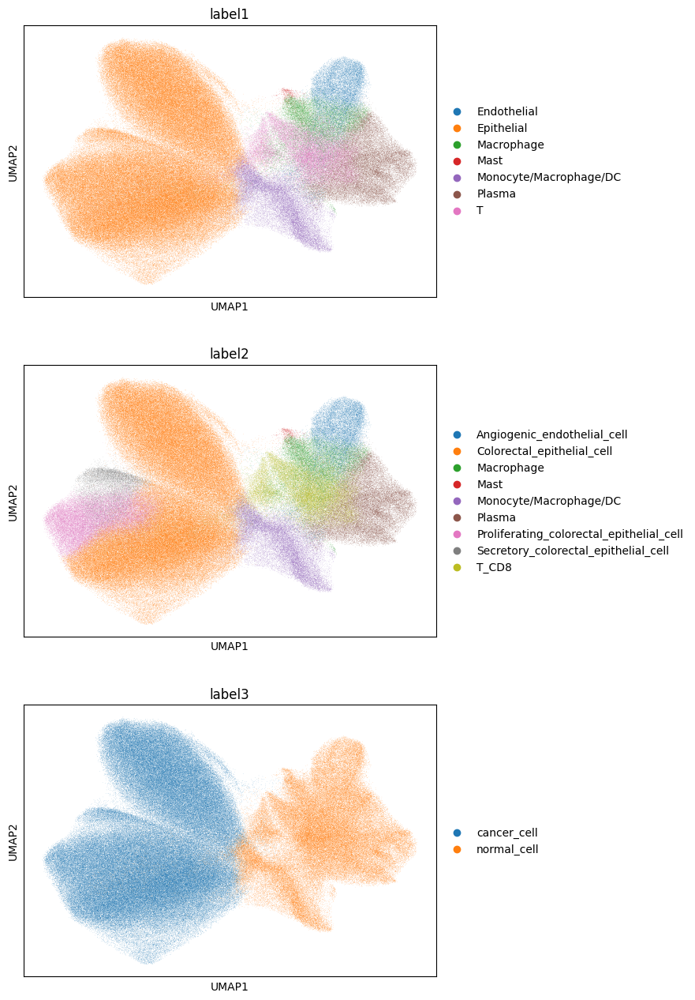

In [123]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [124]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,z_level,nucleus_count,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,36,0,0,0,0,36,276.627198,78.978284,cell_labels,5.0,1.0,3,2,7,7,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
2,aaaaaaac-1,15,0,0,0,0,15,83.855159,8.579688,cell_labels,4.0,1.0,3,2,7,7,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
3,aaaaaaad-1,62,0,0,0,0,62,202.390320,33.867189,cell_labels,4.0,1.0,2,3,5,5,T,T_CD8,normal_cell
4,aaaaaaae-1,12,0,0,0,0,12,74.417503,12.237344,cell_labels,4.0,1.0,3,2,7,7,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
6,aaaaaaag-1,13,0,0,0,0,13,71.662971,11.379375,cell_labels,4.0,1.0,3,5,7,7,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
388170,aaafomek-1,184,0,0,0,0,184,83.042347,36.666876,cell_labels,7.0,1.0,0,0,8,8,Epithelial,Colorectal_epithelial_cell,cancer_cell
388171,aaafomel-1,134,0,0,0,0,134,62.044690,33.054376,cell_labels,8.0,1.0,0,0,2,2,Epithelial,Colorectal_epithelial_cell,cancer_cell
388172,aaafomem-1,166,0,0,0,0,166,75.501253,35.763751,cell_labels,8.0,1.0,0,0,8,8,Epithelial,Colorectal_epithelial_cell,cancer_cell
388173,aaafomen-1,99,0,0,0,0,99,50.258908,29.667657,cell_labels,8.0,1.0,0,0,8,8,Epithelial,Colorectal_epithelial_cell,cancer_cell


In [125]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")